In [4]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import sys
import time
from sklearn.linear_model import LinearRegression

In [5]:
# Function for computing Harris Corners
# Inputs:
# Image - Desirded image
# Threshold - Desired threshold for keeping the best corners 
# BlockSize - It is the size of neighbourhood considered for corner detection
# ApertureSize - Aperture parameter of the Sobel derivative used.
# k - Harris detector free parameter in the equation R=det(M)−k(trace(M))^2

def Get_harris_Corners(image, threshold, blockSize, apertureSize, k):
    
    #transform image to grayscale
    gray_image=cv.cvtColor(image,cv.COLOR_BGR2GRAY)
    #convert image array to float32 type
    gray_image = np.float32(gray_image)
    
    Corner_harris = cv.cornerHarris(gray_image,blockSize, apertureSize, k)
    # Dilation for marking the corners inside the Image, only for presentation purposes
    dest = cv.dilate(Corner_harris, None)
    image[dest > np.quantile(dest, 1-threshold)]=[0, 0, 255]
    
    # Find which Key Points are important by defining a threshold
    
    Kps= np.argwhere(dest > np.quantile(dest, 1-threshold))
    Key_point = []
    for point in Kps:
        Key_point.append(cv.KeyPoint(float(point[1]),float(point[0]),13))
        
    return image, Key_point


# Compute SIFT descriptors
# Inputs:
# Image - desired image
# Kps - key points from Harris Corners
# Output:
# Keypoints
# Descriptors 
def compute_SIFT(image,kps):
    descriptor = cv.SIFT_create()
    #xfeatures2d.
    (kps, features) = descriptor.compute(image,kps)
    return (kps, features)

# Normalize Descriptors
# Inputs:
# Descriptor - Desired descriptors
# Method - Desired method (NORM_L2,NORM_L1,NORM_L3 etc)
def norm_descriptors(descriptor,method):
    descriptor_norm=descriptor
    for i in range(len(descriptor)):
        descriptor_norm[i]=descriptor[i]/cv.norm(descriptor[i], method)
    return descriptor_norm

# Find euklidian distance between descriptors 
# Inputs:
# ds1: Descriptor list 1
# ds2: Descriptor list 2

def euklidian_dist_descriptor(ds1,ds2):
    Euklidian=[ [ None ] * len(ds2) ] * len(ds1)
    for i in range(len(ds1)):
        for k in range(len(ds2)):
            distances = np.linalg.norm(ds1[i] - ds2[k], ord=2)
            Euklidian[i][k]=distances
    return Euklidian

# Find Normalized correlation between descriptors 
# Inputs:
# ds1: Descriptor list 1
# ds2: Descriptor list 2
def Normalized_corr(ds1,ds2):
    Nor_Cor=[ [ None ] * len(ds2) ] * len(ds1)
    for i in range(len(ds1)):
        for k in range(len(ds2)):
            my_rho = np.corrcoef(ds1[i], ds2[k])[0][1]
            Nor_Cor[i][k]=my_rho
    return Nor_Cor


# Function to find best matches between to images
# Inputs:
# img_l - Left image
# img_r - Right image
# n_matches - Number of desired matched
# kps_1 - Key points from left image (Computed from SIFT method)
# kps_2 - Key points from right image (Computed from SIFT method)
# ftr_l - Descriptors from left image (Computed from SIFT method)
# ftr_r - Descriptors from right image (Computed from SIFT method)
# Outputs:
# matched_image - Images with lines between best matches for presentation
# matches - Best matches
def matches(img_l, img_r, n_matches, kps_1, kps_2, ftr_l, ftr_r):
    # create feature matcher
    bf = cv.BFMatcher(cv.NORM_L2, crossCheck=True)
    # match descriptors of both images
    matches = bf.match(ftr_l,ftr_r)
    # sort matches by distance
    matches = sorted(matches, key = lambda x:x.distance)
    # draw first n matches
    matched_image = cv.drawMatches(img_l, kps_1, img_r, kps_2, matches[:n_matches], img_r, flags=2)
    return matched_image, matches[:n_matches]

# Function for finding the coefficient for Affine Matrix
# Inputs:
# Cord_list_left: Cordinations of left selected by ransac
# Cord_list_left: Cordinations of right selected by ransac
# Output:
# a1,b1,c1,a2,b2,c2 : Which are the coefficients from the lines that fits the point we gave
# Based on those coefficients we build the affine matrix
def find_2_line(Cord_list_left, Cord_list_right):
    
    X_bar= Cord_list_right[:,0]
    Y_bar= Cord_list_right[:,1]
        
        
    X = Cord_list_left
    reg_x = LinearRegression().fit(X, X_bar)
    reg_y = LinearRegression().fit(X, Y_bar)    
    a1,b1,c1=reg_x.coef_[0],reg_x.coef_[1],reg_x.intercept_
    a2,b2,c2=reg_y.coef_[0],reg_y.coef_[1],reg_y.intercept_
    
    return a1,b1,c1,a2,b2,c2


# Function for RANSAC
# Inputs:
# KP_left: Cordinations of left selected by ransac
# KP_right: Cordinations of right selected by ransac
# Threshold: Is the ration inliers/all points that we use. If the line can describe more points 
#            than this threshold then we stop the ransac an we return the coefficients that describe that line
# Margin: How far from line we can axcept a point to be
# Init_point: The number for the initial points to randomly select and initialize the whole process
# Output:
# a1,b1,c1,a2,b2,c2 : Which are the coefficients from the best lines that fits the point 
# inliers: Indeces of all inliers 

def Ransac(KP_left, KP_right, Threshold, Margin, Init_point):
    Counter_iteration=0
    ratio=0
    
    while ratio<=Threshold:
    
        rand_index=np.random.randint(len(KP_left), size=Init_point)
        random_init_point_left=np.array(KP_left)[rand_index]
        random_init_point_right=np.array(KP_right)[rand_index]
        inliers=[]
        
        a1,b1,c1,a2,b2,c2 =find_2_line(random_init_point_left,random_init_point_right)
        error=[]
        for index in range(len(KP_left)):
            if index not in rand_index:
                x=KP_left[index][0]
                y=KP_left[index][1]
                error_1=abs(KP_right[index][0]-a1*x-b1*y-c1)
                error_2=abs(KP_right[index][1]-a2*x-b2*y-c2)
                if error_1<=Margin and error_2<=Margin:
                    inliers.append(index)
                    error.append(error_1)
                    error.append(error_2)
                
        ratio=len(inliers)/len(KP_left)
        Counter_iteration+=1
        if Counter_iteration==10000:
            sys.exit("RANSAC exceded max iteration")
        
    a1,b1,c1,a2,b2,c2=find_2_line(np.array(KP_left)[inliers],np.array(KP_right)[inliers])
    return a1,b1,c1,a2,b2,c2,inliers

# Function for finding the mean square error of the distance between 
# the point coordinates in one image, and the transformed coordinates of the 
# matching points in the other image
# Inputs: 
# a1,b1,c1,a2,b2,c2 : Which are the coefficients from the best lines that fits the point 
# index_inliers: Indeces of all inliers 
# Kp_left: Coordinates of the descriptors on left image
# Kp_right: Coordinates of the descriptors on right image
# Outputs:
# MSE: Meas Square Error
def Mean_SE (a1,b1,c1,a2,b2,c2,index_inliers, Kp_left, Kp_right):
    left_point = np.array(Kp_left)[index_inliers]
    right_points = np.array(Kp_right)[index_inliers]
    error_x=[]
    error_y=[]
    for i in range(len(index_inliers)):
        error_x_1=right_points[i][0] - a1*left_point[i][0] - b1*left_point[i][1] - c1
        error_y_1=right_points[i][1] - a2*left_point[i][0] - b2*left_point[i][1] - c2
        error_x.append(error_x_1**2)
        error_y.append(error_y_1**2)
        
    MSE = ((sum(error_x) + sum(error_y))**0.5)/(2*len(index_inliers))
    return(MSE)

In [11]:
# Function for our main program
# Input: 
# image_name_left: The file name of left image
# image_name_right: The file name of right image
# threshold_harris: The Harris threshold
# blockSize_harris: Block size
# n_best_matches: Number of Best matches
# Threshold_ransac: Ransac threshold
# Margin_ransac: Margin for Ransac
# Init_point_ransac: Initial points for ransac

def assignment_1( image_name_left, image_name_right, threshold_harris, blockSize_harris, n_best_matches, Threshold_ransac, Margin_ransac, Init_point_ransac):
    start_time = time.time()
    # Import images
    ### When importing images for test only change image names inside imread
    img_left_orig = cv.imread(image_name_left)
    img_left_orig = cv.cvtColor(img_left_orig, cv.COLOR_BGR2RGB)
    img_left=img_left_orig.copy()

    img_right_orig= cv.imread(image_name_right)
    img_right_orig = cv.cvtColor(img_right_orig, cv.COLOR_BGR2RGB)
    img_right=img_right_orig.copy()
    
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,20))
    ax1.imshow(img_left_orig)
    ax1.set_title("Left original Image", fontsize=20)
    ax2.imshow(img_right_orig)
    ax2.set_title("Right original Image", fontsize=20)

    plt.show()
    img_left, Key_point_left = Get_harris_Corners(img_left, threshold_harris, blockSize_harris, 3, 0.04)
    img_right, Key_point_right = Get_harris_Corners(img_right, threshold_harris, blockSize_harris, 3, 0.04)
    
    print("Compute Harris corners --- %s seconds ---" % (time.time() - start_time))
    step_time = time.time()
    
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,20))
    ax1.imshow(img_left)
    ax1.set_title("Left Image with Harris Corner", fontsize=20)
    ax2.imshow(img_right)
    ax2.set_title("Right Image with Harris Corner", fontsize=20)
    plt.show()
    
    kps_left, features_left = compute_SIFT(img_left,Key_point_left)
    kps_right, features_right = compute_SIFT(img_right,Key_point_right)
    
    print("Compute SIFT descriptors --- %s seconds ---" % (time.time() - step_time))
    step_time = time.time()
    
    fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,20))
    ax1.imshow(cv.drawKeypoints(img_left,kps_left,None))
    ax1.set_title("Left Image with SIFT descriptors", fontsize=20)
    ax2.imshow(cv.drawKeypoints(img_right,kps_right,None))
    ax2.set_title("Right Image with SIFT descriptors", fontsize=20)
    plt.show()

    ############ Below the step 3 was implemented but its computational extensive 
    ############ thats why we dont computed it and printed, if you want you can uncomment the nexr 6 lines
    ############ but you gonna wait really long
# #    features_right_norm=norm_descriptors(features_right, cv.NORM_L2)
# #    features_left_norm=norm_descriptors(features_left, cv.NORM_L2)
    
# #    Euklidian10 = np.array(euklidian_dist_descriptor(features_left_norm[:10],features_right_norm[:10]))
# #    Normalized_correlaion10 = np.array(Normalized_corr(features_left_norm[:10],features_right_norm[:10]))

#####################  
# #    Euklidian = np.array(euklidian_dist_descriptor(features_left_norm,features_right_norm))
# #    Normalized_correlaion = np.array(Normalized_corr(features_left_norm,features_right_norm))
#####################

    
    
    matched_image, matched_kp = matches(img_left, img_right, n_best_matches, kps_left, kps_right, features_left, features_right)
    
    print("Compute n-best matches --- %s seconds ---" % (time.time() - step_time))
    step_time = time.time()
    
    plt.figure(figsize=(50,20))
    plt.title("Image with "+str(n_best_matches)+" best matches", fontsize=60)
    plt.imshow(matched_image)

    # Translate Key points from memery to coordinates on image
    # We gonna need it for the RANSAC
    list_Key_points_left = [kps_left[mat.queryIdx].pt for mat in matched_kp] 
    list_Key_points_right = [kps_right[mat.trainIdx].pt for mat in matched_kp]
    
    a1,b1,c1,a2,b2,c2,inliers=Ransac(list_Key_points_left, list_Key_points_right, Threshold_ransac, Margin_ransac, Init_point_ransac)

    MSE=Mean_SE(a1,b1,c1,a2,b2,c2,inliers, list_Key_points_left, list_Key_points_right)
    
    print("MSE = "+str(MSE)+"\n")
    
    Inliers_matches=[]
    for inlier in inliers:
        Inliers_matches.append(matched_kp[inlier])
        
    print("Number of inliers = "+str(len(Inliers_matches))+"\n")
    
    print("Compute RANSAC --- %s seconds ---" % (time.time() - step_time))
    step_time = time.time()
    
    inliers_image = cv.drawMatches(img_left_orig, kps_left, img_right_orig, kps_right, Inliers_matches,
                               img_right_orig, flags=2)
    # show the image
    plt.figure(figsize=(50,20))
    plt.title("Image with "+str(len(Inliers_matches))+" inliers", fontsize=60)
    plt.imshow(inliers_image)

    Affine_matrix=np.array([[a1,b1,c1],[a2,b2,c2],[0,0,1]])
    
    warp_dst = cv.warpPerspective(img_right_orig, np.linalg.inv(Affine_matrix), ((img_left.shape[1]+img_right.shape[1]), img_right.shape[0]))
    
    warp_dst[0:img_right.shape[0],0:img_left.shape[1]]=img_left_orig
    plt.figure(figsize=(50,20))
    plt.title("Final Image", fontsize=60)
   
    plt.imshow(warp_dst)
    
    print("Total time --- %s seconds ---" % (time.time() - start_time))
    return

assignment_1( image_name_left='img_left.png', image_name_right='img_right.png', threshold_harris=0.01, 
blockSize_harris=5, n_best_matches=50, Threshold_ransac=0.95, Margin_ransac=1, Init_point_ransac=3)


assignment_1( image_name_left='img1.png', image_name_right='img2.png', threshold_harris=0.01, 
blockSize_harris=5, n_best_matches=100, Threshold_ransac=0.95, Margin_ransac=1, Init_point_ransac=3)


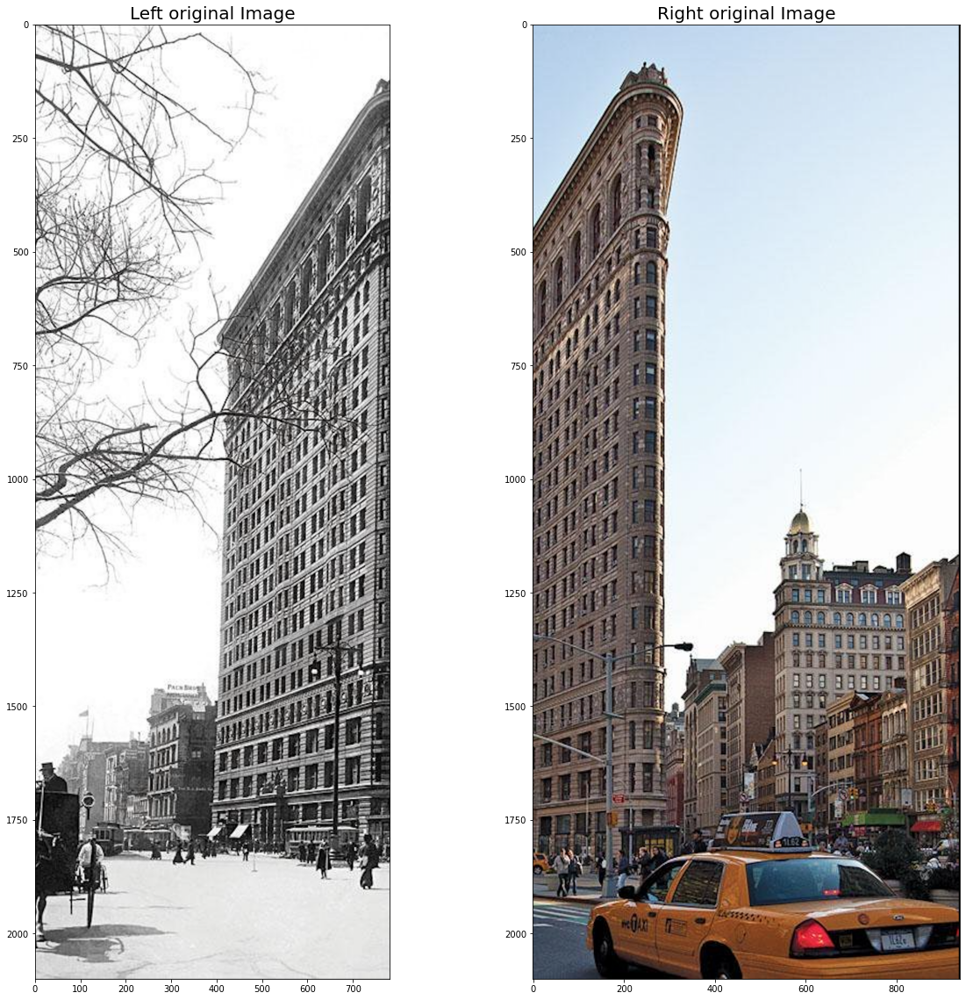

Compute Harris corners --- 0.9321160316467285 seconds ---


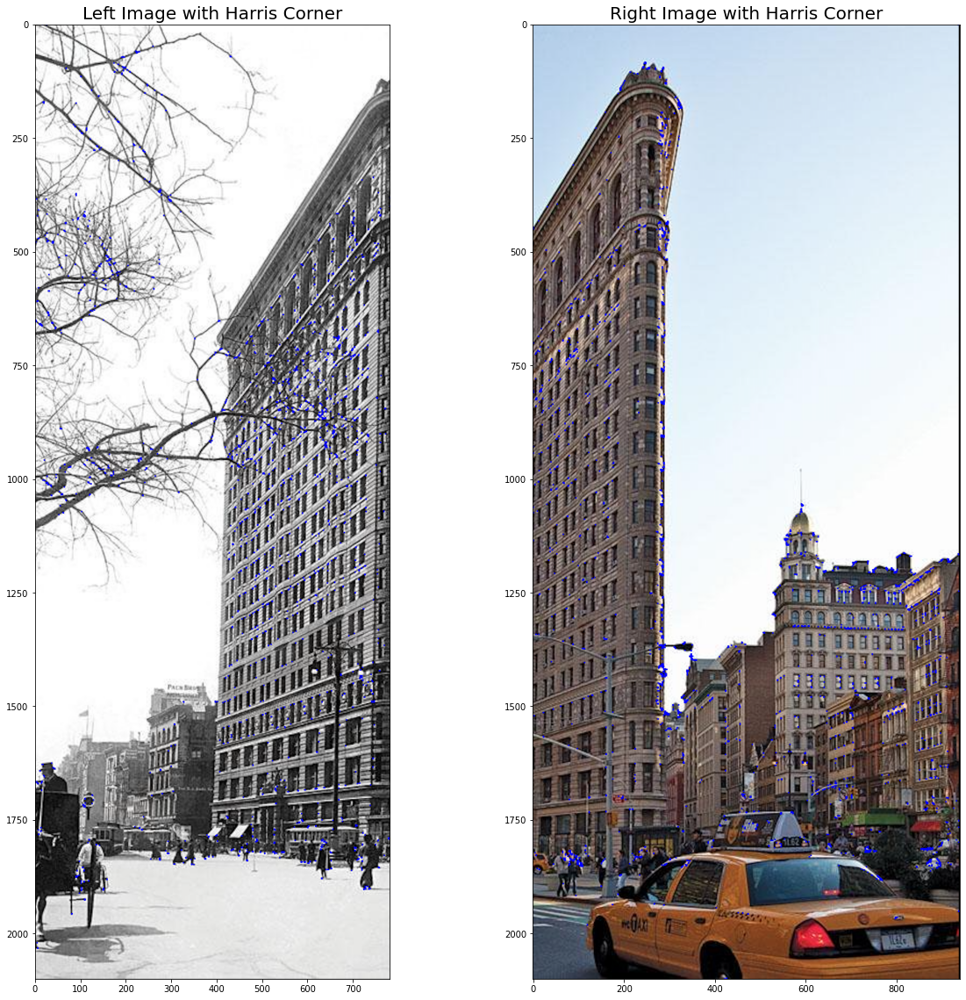

Compute SIFT descriptors --- 1.4785113334655762 seconds ---


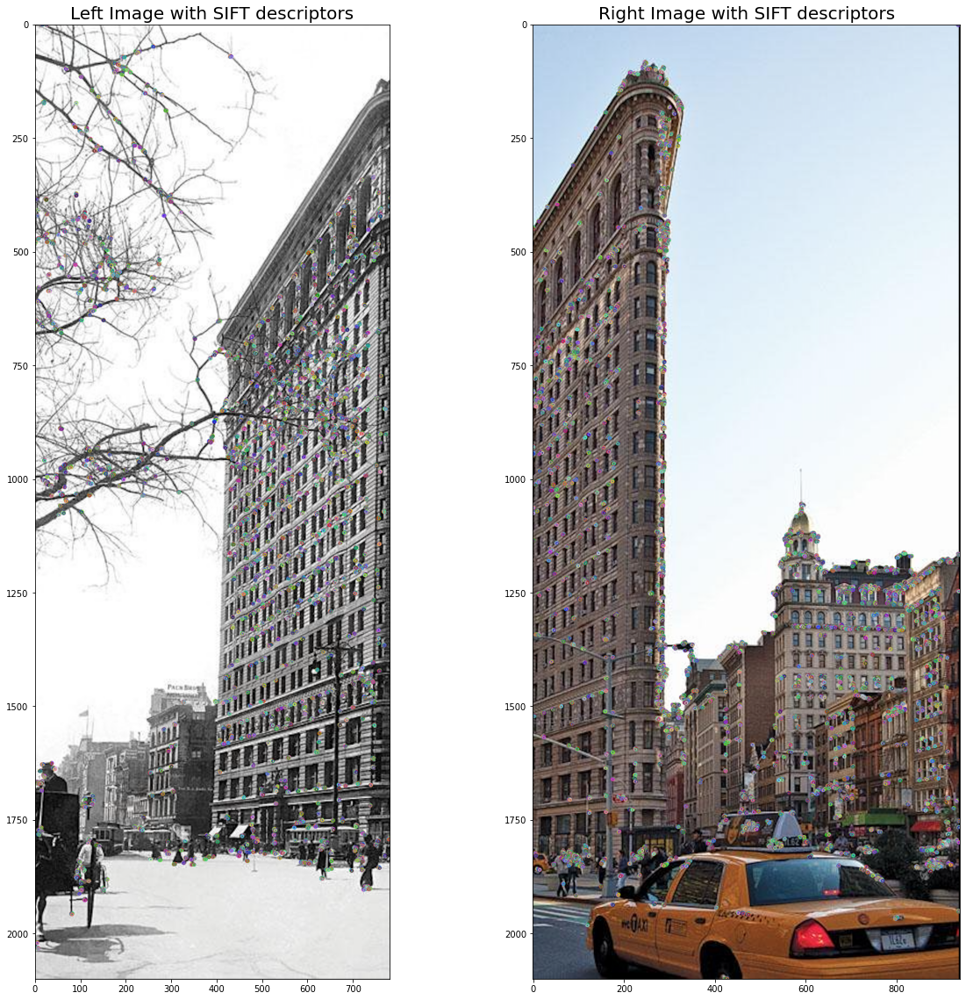

Compute n-best matches --- 2.270843982696533 seconds ---
MSE = 0.09815869400530329

Number of inliers = 52

Compute RANSAC --- 0.1289198398590088 seconds ---
Total time --- 4.926033020019531 seconds ---


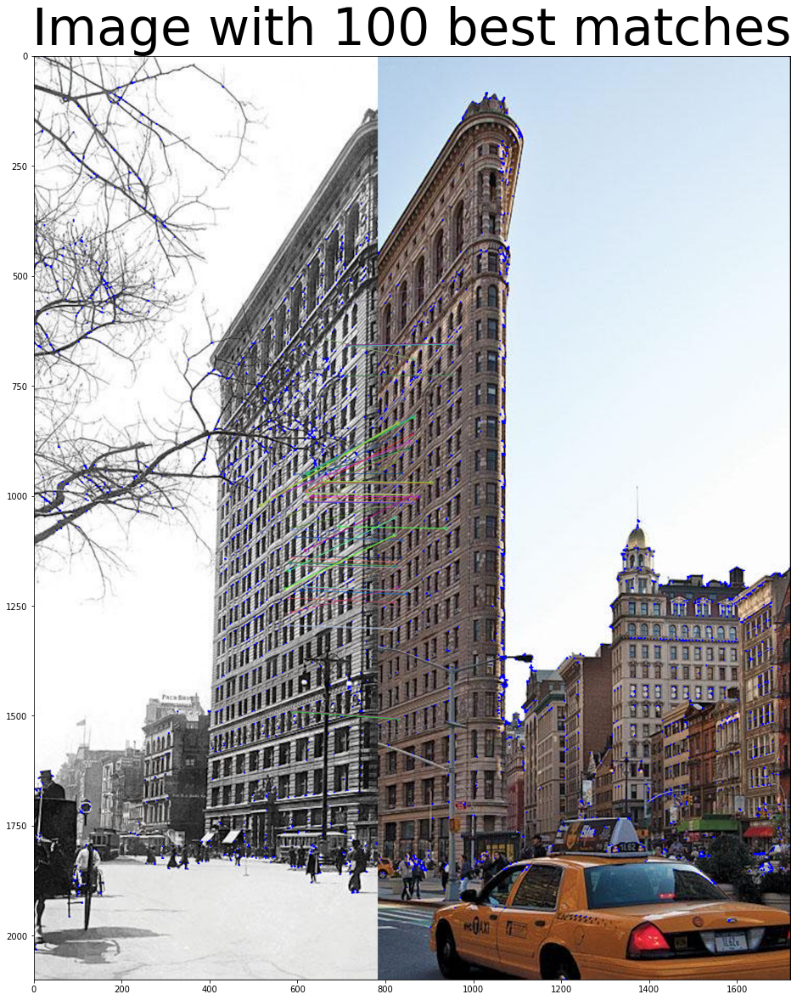

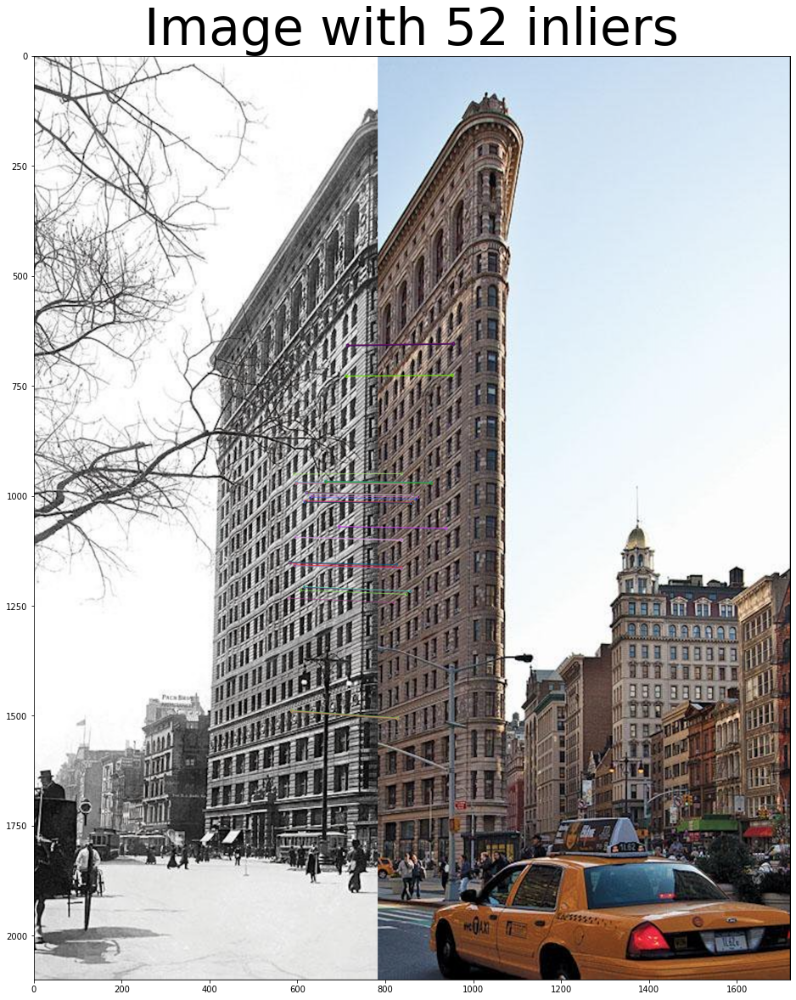

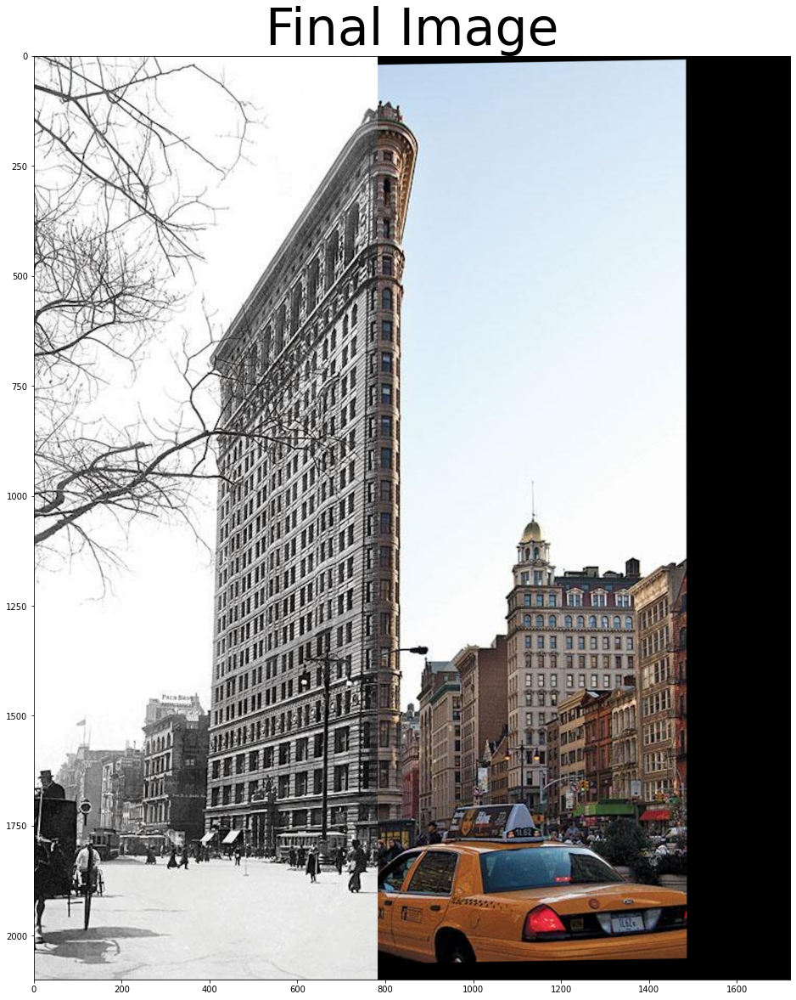

In [6]:
assignment_1( image_name_left='test_L2.png', image_name_right='test_R.png', threshold_harris=0.01, 
blockSize_harris=2, n_best_matches=100, Threshold_ransac=0.5, Margin_ransac=3, Init_point_ransac=3)

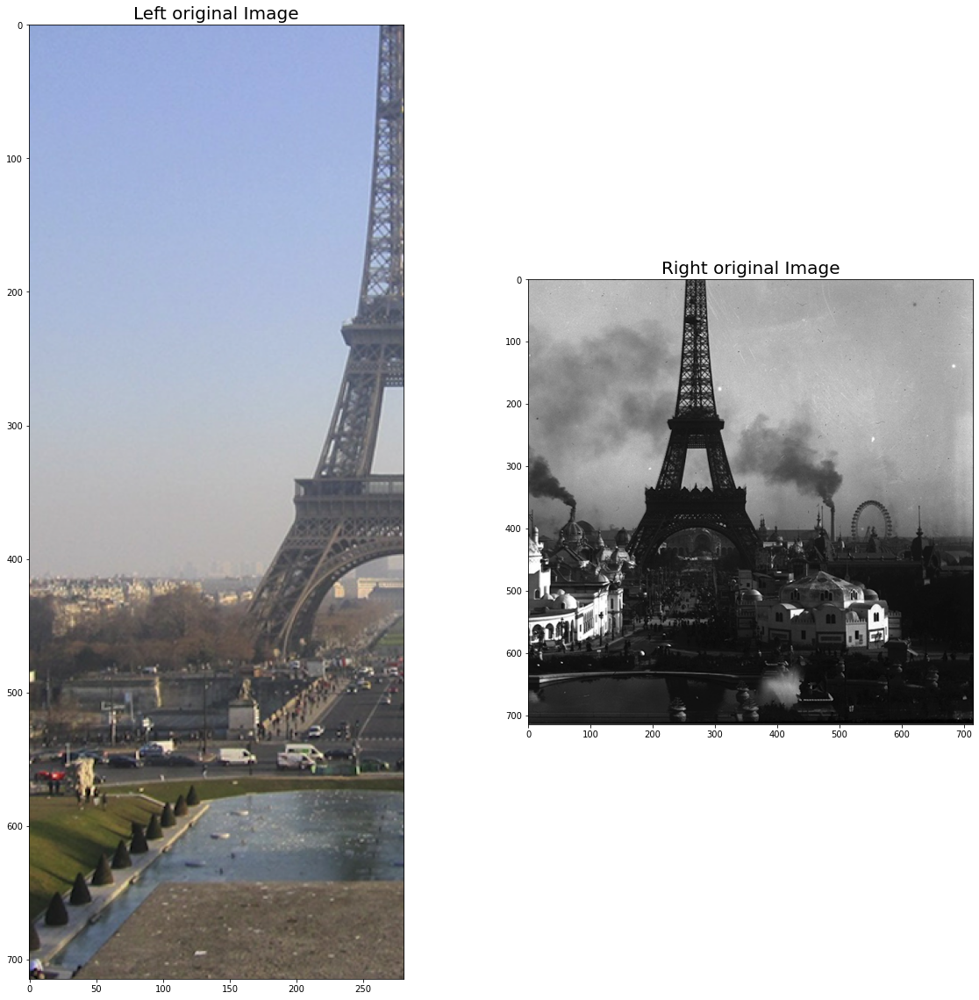

Compute Harris corners --- 0.6699206829071045 seconds ---


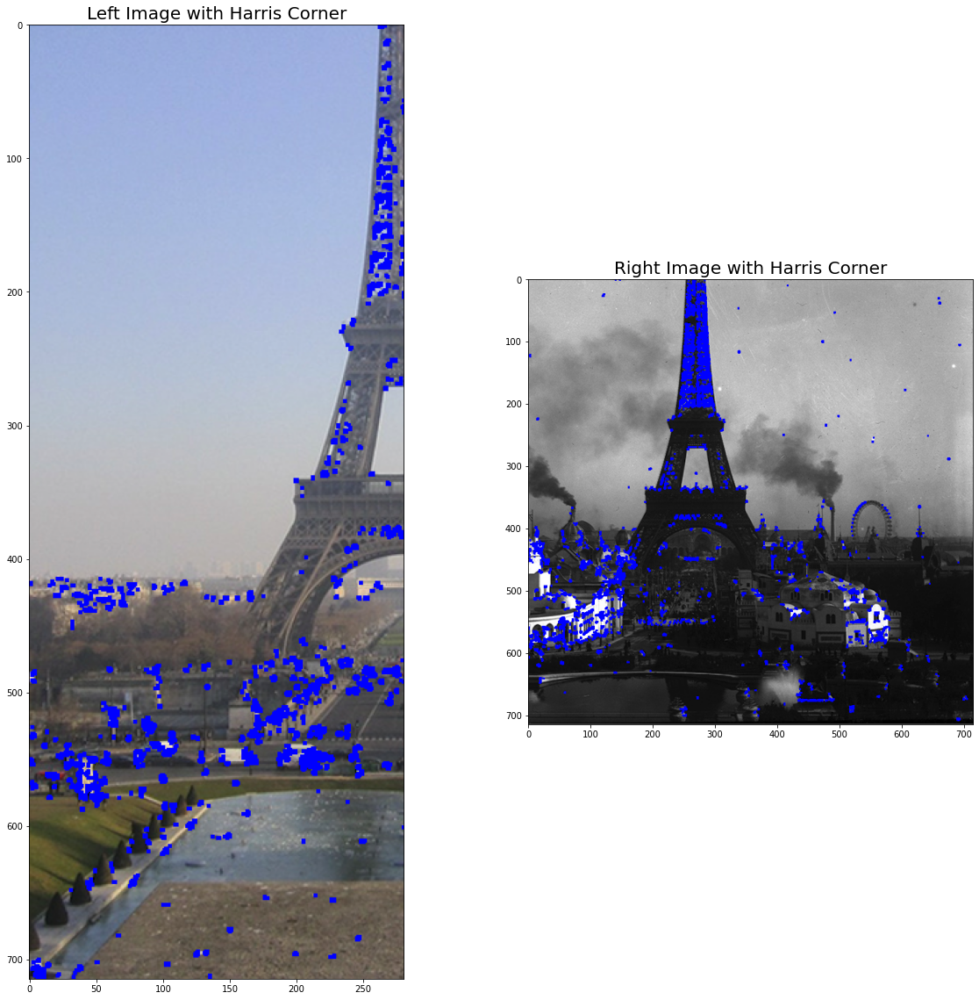

Compute SIFT descriptors --- 1.3089110851287842 seconds ---


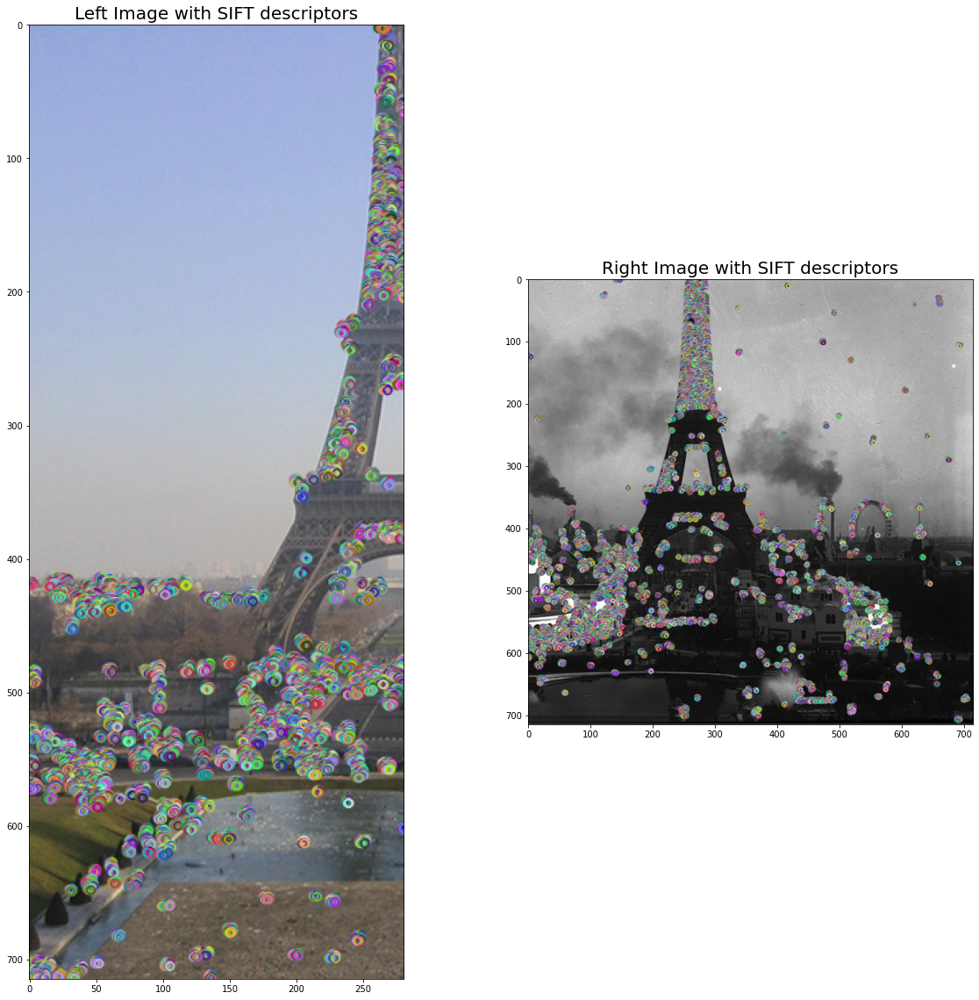

Compute n-best matches --- 1.864485263824463 seconds ---
MSE = 0.09440674995573359

Number of inliers = 66

Compute RANSAC --- 0.20809292793273926 seconds ---
Total time --- 4.083355903625488 seconds ---


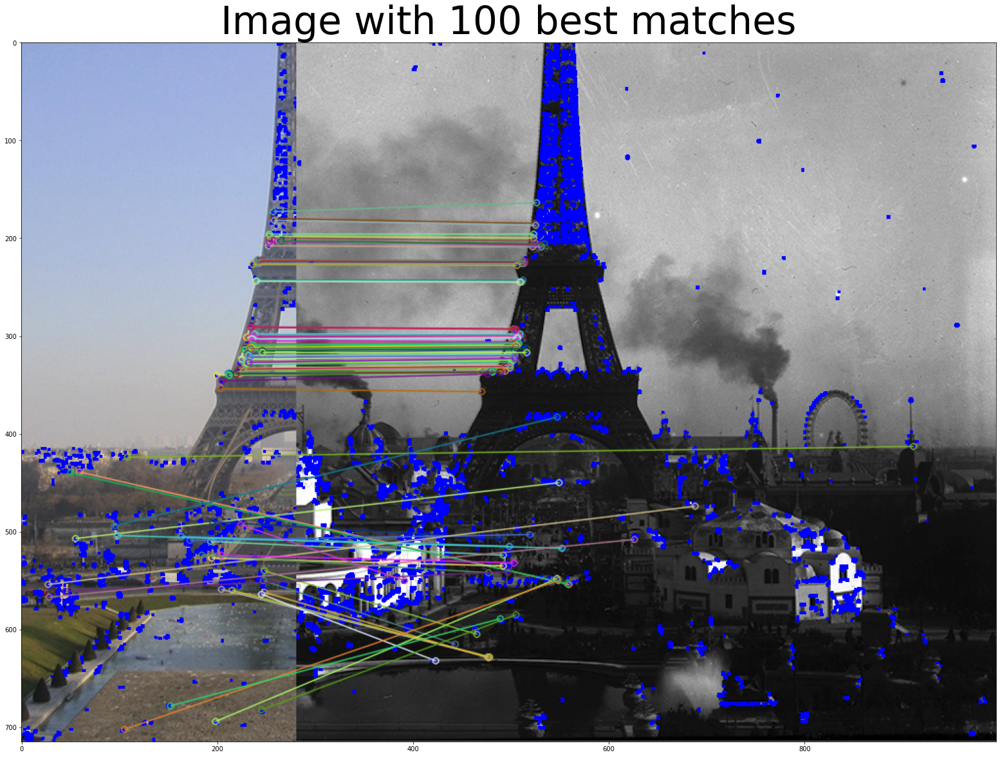

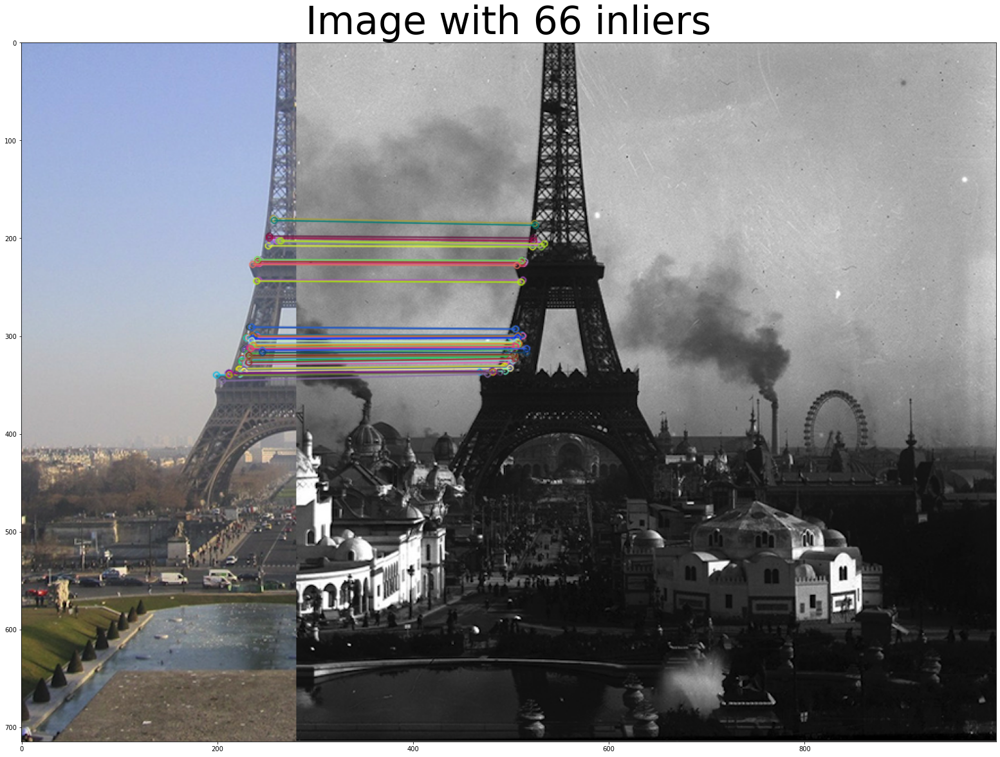

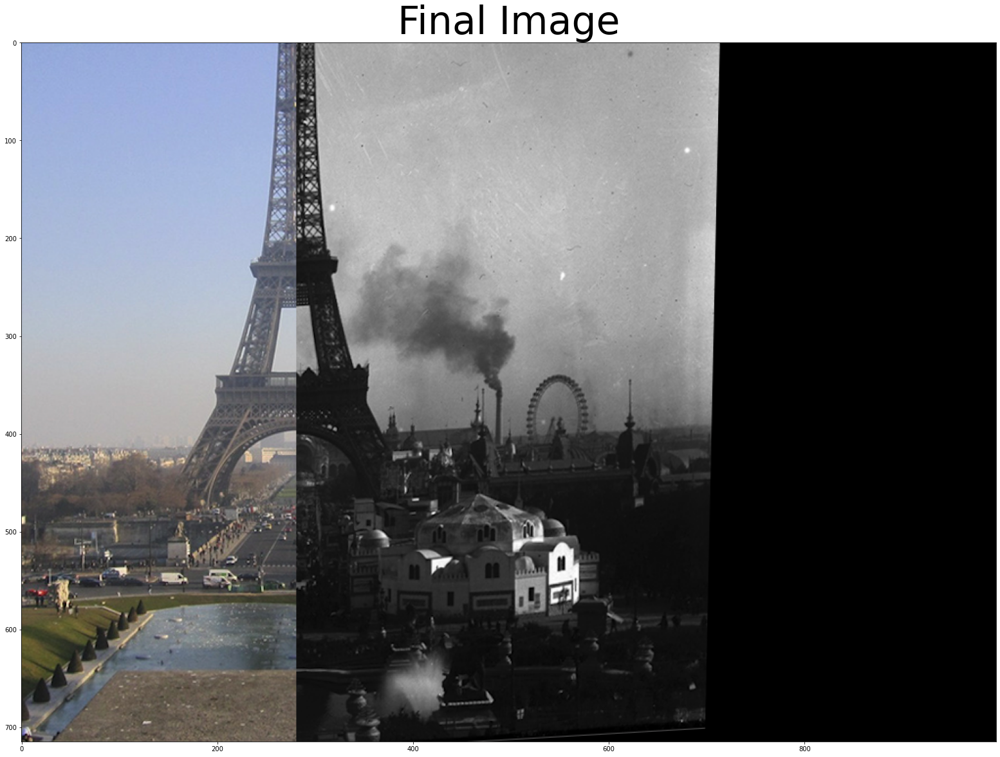

In [21]:
assignment_1( image_name_left='Paris_left.png', image_name_right='Paris_right.png', threshold_harris=0.05, 
blockSize_harris=2, n_best_matches=100, Threshold_ransac=0.65, Margin_ransac=3, Init_point_ransac=3)

In [ ]:
### For ploting the results we run every time with different parameters and kept the MSE below. 

In [15]:
MSE_Harris_thres=[0.027624701383443175,0.008809870217550283,0.017134119744718863,0.011823591992938335,0.024915918688658008,0.013877076723378973,0.011489357400153298]
Harris_thres=[50,40,30,20,10,4,1]
MSE_Block_size=[0.025391514730460064,0.019420880929460996,0.023997827112870188,0.011489357400153298]
Block_size=[2,3,4,5]
MSE_N_BM=[0.01777313661338084,0.012905658390273946,0.02242017198566098,0.022216517961618915]
N_BM=[50,100,200,300]

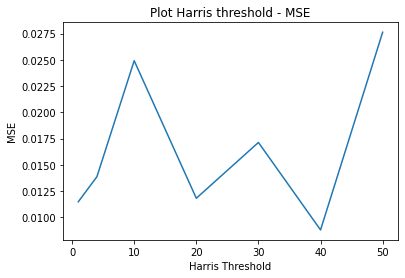

In [16]:
plt.figure()
plt.plot(Harris_thres, MSE_Harris_thres)
plt.xlabel('Harris Threshold')
plt.ylabel('MSE')
plt.title('Plot Harris threshold - MSE')
plt.show()

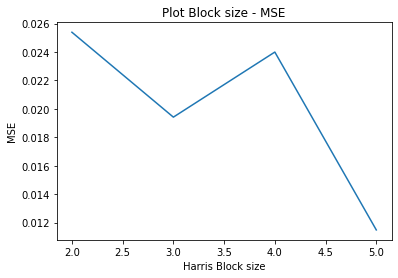

In [17]:
plt.figure()
plt.plot(Block_size, MSE_Block_size)
plt.xlabel('Harris Block size')
plt.ylabel('MSE')
plt.title('Plot Block size - MSE')
plt.show()

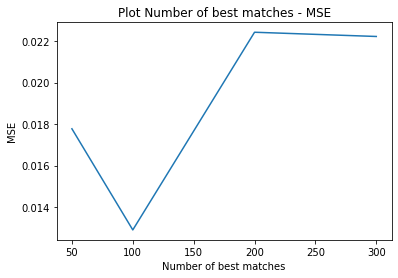

In [18]:
plt.figure()
plt.plot(N_BM,MSE_N_BM)
plt.xlabel('Number of best matches')
plt.ylabel('MSE')
plt.title('Plot Number of best matches - MSE')
plt.show()